In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np 
%matplotlib inline
import dask.dataframe as dd

## Step 0 : Reading the data ##

In [2]:
df = pd.read_csv('Airbnb_Open_Data.csv')
df.head()


/tmp/ipykernel_771/1202269202.py:1: DtypeWarning: Columns (25) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv('Airbnb_Open_Data.csv')


,id,NAME,host id,host_identity_verified,host name,neighbourhood group,neighbourhood,lat,long,country,...,service fee,minimum nights,number of reviews,last review,reviews per month,review rate number,calculated host listings count,availability 365,house_rules,license
0,1001254,Clean & quiet apt home by the park,80014485718,unconfirmed,Madaline,Brooklyn,Kensington,40.64749,-73.97237,United States,...,$193,10.0,9.0,10/19/2021,0.21,4.0,6.0,286.0,Clean up and treat the home the way you'd like...,NaN
1,1002102,Skylit Midtown Castle,52335172823,verified,Jenna,Manhattan,Midtown,40.75362,-73.98377,United States,...,$28,30.0,45.0,5/21/2022,0.38,4.0,2.0,228.0,Pet friendly but please confirm with me if the...,NaN
2,1002403,THE VILLAGE OF HARLEM....NEW YORK !,78829239556,NaN,Elise,Manhattan,Harlem,40.80902,-73.94190,United States,...,$124,3.0,0.0,NaN,NaN,5.0,1.0,352.0,"I encourage you to use my kitchen, cooking and...",NaN
3,1002755,NaN,85098326012,unconfirmed,Garry,Brooklyn,Clinton Hill,40.68514,-73.95976,United States,...,$74,30.0,270.0,7/5/2019,4.64,4.0,1.0,322.0,NaN,NaN
4,1003689,Entire Apt: Spacious Studio/Loft by central park,92037596077,verified,Lyndon,Manhattan,East Harlem,40.79851,-73.94399,United States,...,$41,10.0,9.0,11/19/2018,0.10,3.0,1.0,289.0,"Please no smoking in the house, porch or on th...",NaN


In [3]:
## need to see an overview of the features and targets
df.shape

(102599, 26)

In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 102599 entries, 0 to 102598
Data columns (total 26 columns):
 #   Column                          Non-Null Count   Dtype  
---  ------                          --------------   -----  
 0   id                              102599 non-null  int64  
 1   NAME                            102349 non-null  object 
 2   host id                         102599 non-null  int64  
 3   host_identity_verified          102310 non-null  object 
 4   host name                       102193 non-null  object 
 5   neighbourhood group             102570 non-null  object 
 6   neighbourhood                   102583 non-null  object 
 7   lat                             102591 non-null  float64
 8   long                            102591 non-null  float64
 9   country                         102067 non-null  object 
 10  country code                    102468 non-null  object 
 11  instant_bookable                102494 non-null  object 
 12  cancellation_pol

## Step 1: Cleaning the data ##

In [5]:
df1 = df.copy()

In [6]:
sanitydf = df.isnull()
sanitydf.head()


,id,NAME,host id,host_identity_verified,host name,neighbourhood group,neighbourhood,lat,long,country,...,service fee,minimum nights,number of reviews,last review,reviews per month,review rate number,calculated host listings count,availability 365,house_rules,license
0,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,True
1,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,True
2,False,False,False,True,False,False,False,False,False,False,...,False,False,False,True,True,False,False,False,False,True
3,False,True,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,True,True
4,False,False,False,False,False,False,False,False,False,False,...,False,False,False,False,False,False,False,False,False,True


In [7]:
"""
for col in sanitydf.columns.values:
    print(col)
    print(sanitydf[col].value_counts());
"""
## Another way to visualize the null values is :
df.isnull().sum().sort_values(ascending = False)

license                           102597
house_rules                        52131
last review                        15893
reviews per month                  15879
country                              532
availability 365                     448
minimum nights                       409
host name                            406
review rate number                   326
calculated host listings count       319
host_identity_verified               289
service fee                          273
NAME                                 250
price                                247
Construction year                    214
number of reviews                    183
country code                         131
instant_bookable                     105
cancellation_policy                   76
neighbourhood group                   29
neighbourhood                         16
long                                   8
lat                                    8
id                                     0
host id         

In [8]:
## License column seems to have only 1 entry that are not null 
df.loc[~df['license'].isnull()]

,id,NAME,host id,host_identity_verified,host name,neighbourhood group,neighbourhood,lat,long,country,...,service fee,minimum nights,number of reviews,last review,reviews per month,review rate number,calculated host listings count,availability 365,house_rules,license
11114,7139598,"Cozy 1 BR on Bedford Avenue, Wburg",73023181304,verified,Christina,Brooklyn,Williamsburg,40.71764,-73.95689,United States,...,$140,1.0,1.0,1/3/2016,0.02,1.0,1.0,191.0,"Dear Guest, Thank you for appreciating that I ...",41662/AL
72947,41289964,"Cozy 1 BR on Bedford Avenue, Wburg",25804773951,unconfirmed,Christina,Brooklyn,Williamsburg,40.71764,-73.95689,United States,...,$140,1.0,1.0,1/3/2016,0.02,1.0,1.0,0.0,NaN,41662/AL


In [9]:
## since the feature license does not have enough substantial data entries it will not be able to contribute to 
## any model efficiently , so the best way would be to remove the entire column
df1 = df1.drop('license',axis = 1)
df1.head()

,id,NAME,host id,host_identity_verified,host name,neighbourhood group,neighbourhood,lat,long,country,...,price,service fee,minimum nights,number of reviews,last review,reviews per month,review rate number,calculated host listings count,availability 365,house_rules
0,1001254,Clean & quiet apt home by the park,80014485718,unconfirmed,Madaline,Brooklyn,Kensington,40.64749,-73.97237,United States,...,$966,$193,10.0,9.0,10/19/2021,0.21,4.0,6.0,286.0,Clean up and treat the home the way you'd like...
1,1002102,Skylit Midtown Castle,52335172823,verified,Jenna,Manhattan,Midtown,40.75362,-73.98377,United States,...,$142,$28,30.0,45.0,5/21/2022,0.38,4.0,2.0,228.0,Pet friendly but please confirm with me if the...
2,1002403,THE VILLAGE OF HARLEM....NEW YORK !,78829239556,NaN,Elise,Manhattan,Harlem,40.80902,-73.94190,United States,...,$620,$124,3.0,0.0,NaN,NaN,5.0,1.0,352.0,"I encourage you to use my kitchen, cooking and..."
3,1002755,NaN,85098326012,unconfirmed,Garry,Brooklyn,Clinton Hill,40.68514,-73.95976,United States,...,$368,$74,30.0,270.0,7/5/2019,4.64,4.0,1.0,322.0,NaN
4,1003689,Entire Apt: Spacious Studio/Loft by central park,92037596077,verified,Lyndon,Manhattan,East Harlem,40.79851,-73.94399,United States,...,$204,$41,10.0,9.0,11/19/2018,0.10,3.0,1.0,289.0,"Please no smoking in the house, porch or on th..."


In [10]:
## next missing value is the house rules part which is a text input.There are too many missing values for us to omit the data points completely but since it is a
## text input we cannot compute the mean either. For the places with missing house rules replace with blank 

In [11]:
df1['house_rules'].replace(np.nan, ' ',inplace = True)

In [12]:
#sanity check 
sdf = df1['house_rules'].isnull()
sdf.value_counts()

False    102599
Name: house_rules, dtype: int64

In [13]:
## next missing value is a date , first let us check if the column is in the correct data type
df1['last review']

0         10/19/2021
1          5/21/2022
2                NaN
3           7/5/2019
4         11/19/2018
             ...    
102594           NaN
102595      7/6/2015
102596           NaN
102597    10/11/2015
102598           NaN
Name: last review, Length: 102599, dtype: object

In [14]:
df1['last review'] = pd.to_datetime(df1['last review'])

In [15]:
df1['last review']

0        2021-10-19
1        2022-05-21
2               NaT
3        2019-07-05
4        2018-11-19
            ...    
102594          NaT
102595   2015-07-06
102596          NaT
102597   2015-10-11
102598          NaT
Name: last review, Length: 102599, dtype: datetime64[ns]

In [16]:
## Ideally if the last review is not present we will assume that the property has not been reviewed before and
## would want to give the listing date. Since listing date is not part of the data, we can use the minimum date
## from the last review column

In [17]:
## check the min and max timestamps
print('Earliest review date :',df1['last review'].min(), '\nLatest review date:',df1['last review'].max())

Earliest review date : 2012-07-11 00:00:00 
Latest review date: 2058-06-16 00:00:00


In [18]:
## here the latest review date is clearly an impossible date 
## we need to remove any date older than the current date 

In [19]:
df1[df1['last review'].apply(lambda x: x.year >2022)]

,id,NAME,host id,host_identity_verified,host name,neighbourhood group,neighbourhood,lat,long,country,...,price,service fee,minimum nights,number of reviews,last review,reviews per month,review rate number,calculated host listings count,availability 365,house_rules
127,1071478,Garden studio in the Upper East Sid,77172555024,unconfirmed,Miller,Manhattan,Upper East Side,40.77800,-73.94822,United States,...,$571,$114,5.0,21.0,2024-08-15,0.19,4.0,NaN,395.0,"Dear Guests, Welcome to 62 Cornwall St! I hope..."
191,1106825,LUX APT IN TIMES SQUARE NEW BUILDING,93725364475,unconfirmed,Aiden,Manhattan,Hell's Kitchen,40.76307,-73.99665,United States,...,$539,$108,NaN,41.0,2025-06-26,0.38,2.0,1.0,NaN,"You will be sharing a bathroom, so you must be..."
255,1142173,Beautiful Landmarked Duplex,87944779917,NaN,Baker,Brooklyn,Greenpoint,40.72945,-73.95511,United States,...,$842,$168,3.0,124.0,2058-06-16,1.22,4.0,3.0,230.0,No rules per say. I just ask that you respect ...
318,1176967,NaN,70084472212,verified,Barnes,Brooklyn,Greenpoint,40.72488,-73.95018,United States,...,$920,$184,2.0,1.0,2026-03-28,0.01,3.0,1.0,73.0,Check-In is 3pm. Check-Out is 12 Noon. In or...
483,1268097,Modern Space in Charming Pre-war,13746585241,verified,Adelaide,Manhattan,Harlem,40.82411,-73.94934,United States,...,$721,$144,2.0,41.0,2040-06-16,0.43,3.0,2.0,47.0,


In [20]:
## replacing the year with the median year

df1.loc[df1[df1['last review'].apply(lambda x: x.year> 2022)].index, 'last review'] = df1['last review'].median()

In [21]:
## sanity check 
df1[df1['last review'].apply(lambda x: x.year > 2022)]

,id,NAME,host id,host_identity_verified,host name,neighbourhood group,neighbourhood,lat,long,country,...,price,service fee,minimum nights,number of reviews,last review,reviews per month,review rate number,calculated host listings count,availability 365,house_rules


In [22]:
## need to check if there are any duplicate listings 
df1[df1.duplicated()]

,id,NAME,host id,host_identity_verified,host name,neighbourhood group,neighbourhood,lat,long,country,...,price,service fee,minimum nights,number of reviews,last review,reviews per month,review rate number,calculated host listings count,availability 365,house_rules
102058,35506831,Master Bedroom with private Bathroom & Balcony,55110690425,unconfirmed,UZeyir,Queens,Maspeth,40.74056,-73.90635,United States,...,$706,$141,1.0,1.0,2021-11-14,0.27,3.0,1.0,339.0,
102059,35507383,Cozy 2 br in sunny Fort Greene apt,80193772189,verified,Sally,Brooklyn,Fort Greene,40.68701,-73.97555,United States,...,$651,$130,3.0,38.0,2021-11-13,0.27,3.0,1.0,0.0,
102060,35507935,Duplex w/ Terrace @ Box House Hotel,72991962259,verified,The Box House Hotel,Brooklyn,Greenpoint,40.73756,-73.95350,United States,...,$907,$181,3.0,10.0,2021-11-13,0.08,3.0,30.0,32.0,
102061,35508488,"Cozy, clean Greenpoint room with yard access",74975156081,verified,Dawn,Brooklyn,Greenpoint,40.72516,-73.95004,United States,...,$589,$118,30.0,38.0,2021-11-13,0.34,5.0,2.0,324.0,
102062,35509040,2BR XL Loft: Cleaning CDC guidelines implemented,85844415221,unconfirmed,Vida,Brooklyn,Greenpoint,40.72732,-73.94185,United States,...,$356,$71,30.0,13.0,2021-11-13,0.14,4.0,28.0,336.0,
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
102594,6092437,Spare room in Williamsburg,12312296767,verified,Krik,Brooklyn,Williamsburg,40.70862,-73.94651,United States,...,$844,$169,1.0,0.0,NaT,NaN,3.0,1.0,227.0,No Smoking No Parties or Events of any kind Pl...
102595,6092990,Best Location near Columbia U,77864383453,unconfirmed,Mifan,Manhattan,Morningside Heights,40.80460,-73.96545,United States,...,$837,$167,1.0,1.0,2015-07-06,0.02,2.0,2.0,395.0,House rules: Guests agree to the following ter...
102596,6093542,"Comfy, bright room in Brooklyn",69050334417,unconfirmed,Megan,Brooklyn,Park Slope,40.67505,-73.98045,United States,...,$988,$198,3.0,0.0,NaT,NaN,5.0,1.0,342.0,
102597,6094094,Big Studio-One Stop from Midtown,11160591270,unconfirmed,Christopher,Queens,Long Island City,40.74989,-73.93777,United States,...,$546,$109,2.0,5.0,2015-10-11,0.10,3.0,1.0,386.0,


In [23]:
## there are 541 duplicated values and we need to drop these duplicated values 
## drops all the rows which have all the columns with the same entries (i.e 2 rows are identical)
df1.drop_duplicates(keep = 'first',inplace = True)

In [24]:
## sanity check 
df1[df1.duplicated()]

,id,NAME,host id,host_identity_verified,host name,neighbourhood group,neighbourhood,lat,long,country,...,price,service fee,minimum nights,number of reviews,last review,reviews per month,review rate number,calculated host listings count,availability 365,house_rules


In [25]:
## Identify features that need to unique but has duplicated values 

In [26]:
## unique features = [id] , [host id], [lat. long] 

In [27]:
## these 3 features will together be unique to a particular airbnb and cannot be repeated
temp = df1[df1.duplicated(subset = ['host name', 'lat', 'long'])]
temp

,id,NAME,host id,host_identity_verified,host name,neighbourhood group,neighbourhood,lat,long,country,...,price,service fee,minimum nights,number of reviews,last review,reviews per month,review rate number,calculated host listings count,availability 365,house_rules
48881,27998312,The Raccoon Artist Studio in Williamsburg New ...,37925218790,unconfirmed,Melki,Brooklyn,Williamsburg,40.71232,-73.94220,United States,...,$338,$68,1.0,NaN,NaT,NaN,3.0,3.0,NaN,
48888,28002178,Garden Jewel Apartment in Williamsburg New York,13121590064,unconfirmed,Melki,Brooklyn,Williamsburg,40.71232,-73.94220,United States,...,$277,$55,1.0,0.0,NaT,NaN,3.0,3.0,365.0,#NAME?
48896,28006597,Best location in ny,3818126180,unconfirmed,Michael,Manhattan,Hell's Kitchen,40.76802,-73.98721,United States,...,$573,$115,1.0,1.0,2019-06-30,1.00,3.0,6.0,24.0,
48897,28007149,Master bedroom in luxury building,15957734735,unconfirmed,Daniel,Manhattan,Hell's Kitchen,40.76054,-73.99936,United States,...,"$1,071",$214,2.0,0.0,NaT,NaN,4.0,1.0,11.0,
48898,28007701,Beautiful room near central park,52878860024,unconfirmed,Michael,Manhattan,Hell's Kitchen,40.76640,-73.98586,United States,...,$782,$156,1.0,1.0,2019-06-30,1.00,3.0,6.0,24.0,
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
102053,57365208,Cozy bright room near Prospect Park,77326652202,unconfirmed,Mariam,Brooklyn,Flatbush,40.64945,-73.96108,United States,...,$696,NaN,7.0,12.0,2019-03-27,0.44,5.0,1.0,0.0,Shoes off Clean After yourself Turn Lights and...
102054,57365760,Private Bedroom with Amazing Rooftop View,45936254757,verified,Trey,Brooklyn,Bushwick,40.69872,-73.92718,United States,...,$909,NaN,1.0,19.0,2017-08-31,0.72,3.0,2.0,0.0,#NAME?
102055,57366313,Pretty Brooklyn One-Bedroom for 2 to 4 people,23801060917,verified,Michael,Brooklyn,Bedford-Stuyvesant,40.67810,-73.90822,United States,...,$387,NaN,2.0,50.0,2019-06-26,3.12,4.0,2.0,235.0,* Check out: 10am * We made an effort to keep ...
102056,57366865,Room & private bathroom in historic Harlem,15593031571,unconfirmed,Shireen,Manhattan,Harlem,40.81248,-73.94317,United States,...,$848,NaN,2.0,0.0,NaT,NaN,1.0,1.0,0.0,Each of us is working and/or going to school a...


In [28]:
## let us drop these duplicates keeping the first row 
df1.drop_duplicates(subset = ['host name', 'lat', 'long'], keep = 'first', inplace = True)

In [29]:
df1[df1.duplicated(subset = ['host name', 'lat', 'long'])]

,id,NAME,host id,host_identity_verified,host name,neighbourhood group,neighbourhood,lat,long,country,...,price,service fee,minimum nights,number of reviews,last review,reviews per month,review rate number,calculated host listings count,availability 365,house_rules


In [30]:
## let us check the null values again 

df1.isnull().sum().sort_values(ascending = False)

last review                       10095
reviews per month                 10081
minimum nights                      362
availability 365                    321
host name                           312
country                             311
service fee                         233
review rate number                  232
host_identity_verified              216
price                               216
NAME                                206
Construction year                   190
calculated host listings count      143
number of reviews                    99
country code                         86
instant_bookable                     86
cancellation_policy                  57
neighbourhood group                  29
neighbourhood                        16
long                                  8
lat                                   8
id                                    0
room type                             0
host id                               0
house_rules                           0


**Dealing with missing values in 'reviews per month' feature**

In [31]:
!pip install plotly_express

In [32]:
import plotly_express as px

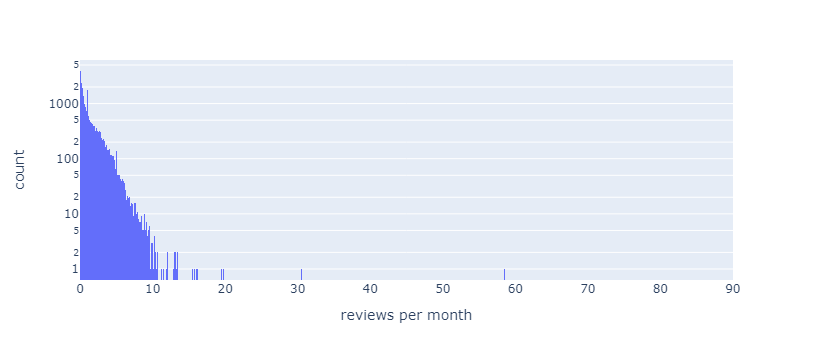

In [33]:
## let us visualize the nature and distribution of the data 
fig = px.histogram(df1,x = 'reviews per month', log_y= True)
fig.show()

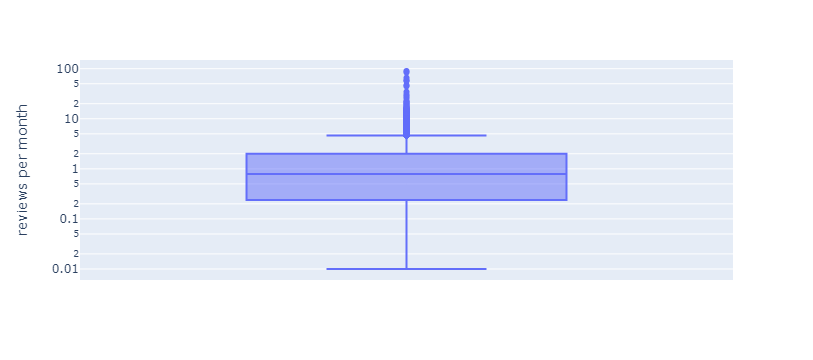

In [34]:
## further visualization with the box plot 
fig = px.box(df1, y = 'reviews per month', log_y = True)
fig.show()

In [35]:
## in a box plot the left whisker generally represents the lower range of the data , since the median is leaning 
## towards the upper range of the distribution and is right skewed so it would better to impute with the median
median = df1['reviews per month'].median()
df1['reviews per month'].replace(np.nan, median, inplace = True)

In [36]:
df1['reviews per month'].isnull().sum()

0

**Dealing with other missing features**

These are the cumulative actions we can take right now:
 1. Impute NAME column with 'blank'
 2. Impute host id with 0
 3. Impute host_identity_verified with 'unconfirmed'
 4. Impute host name with 'blank'


In [37]:
## replace both missing NAME and host name with 'blank'
df1['NAME'].replace(np.nan, 'blank', inplace = True)
df1['host name'].replace(np.nan, 'blank', inplace = True)

## replace host_identity_verified with 'unconfirmed'
df1['host_identity_verified'].replace(np.nan, 'unconfirmed', inplace = True)

## replace the host id with 0 
df1['host id'].replace(np.nan, 0, inplace = True)


**Further cleaning**

In [38]:
print('Unique neighbourhood groups :',df1['neighbourhood group'].nunique())
df1['neighbourhood group'].value_counts()

Unique neighbourhood groups : 7


Manhattan        28660
Brooklyn         27177
Queens            8946
Bronx             1849
Staten Island      626
brookln              1
manhatan             1
Name: neighbourhood group, dtype: int64

In [39]:
## here we can see that manhatan and brookln should belong to Manhattan and Brooklyn respectively
df1['neighbourhood group'].replace('manhatan', 'Manhattan', inplace = True)
df1['neighbourhood group'].replace('brookln', 'Brooklyn' ,inplace = True)

In [40]:
df1['neighbourhood group'].value_counts()

Manhattan        28661
Brooklyn         27178
Queens            8946
Bronx             1849
Staten Island      626
Name: neighbourhood group, dtype: int64

In [41]:
df1['host_identity_verified'].value_counts()

unconfirmed    33770
verified       33519
Name: host_identity_verified, dtype: int64

In [42]:
print('Unique neighbourhoods :' , df1['neighbourhood'].nunique())
df1['neighbourhood'].value_counts()

Unique neighbourhoods : 224


Bedford-Stuyvesant        5196
Williamsburg              4965
Harlem                    3558
Bushwick                  3172
Hell's Kitchen            2704
                          ... 
Rossville                    2
Willowbrook                  2
Glen Oaks                    2
Fort Wadsworth               1
Chelsea, Staten Island       1
Name: neighbourhood, Length: 224, dtype: int64

In [43]:
df1['country'].value_counts()

United States    66978
Name: country, dtype: int64

In [44]:
df1['country code'].value_counts()

US    67203
Name: country code, dtype: int64

In [45]:
## country has zero variability (only one value for all data points) and hence the entire column can be dropped

In [46]:
df1.drop(['country', 'country code'], axis = 1, inplace = True)

In [47]:
df1['instant_bookable'].value_counts()

False    33818
True     33385
Name: instant_bookable, dtype: int64

In [48]:
df1.isnull().sum().sort_values(ascending = False)


last review                       10095
minimum nights                      362
availability 365                    321
service fee                         233
review rate number                  232
price                               216
Construction year                   190
calculated host listings count      143
number of reviews                    99
instant_bookable                     86
cancellation_policy                  57
neighbourhood group                  29
neighbourhood                        16
long                                  8
lat                                   8
reviews per month                     0
id                                    0
room type                             0
NAME                                  0
host name                             0
host_identity_verified                0
host id                               0
house_rules                           0
dtype: int64

In [49]:
## if we know the neighbourhood and the lat and long features are missing we can impute them with the help of 
# geolocate from geopy library

In [50]:
df1[df1[['lat', 'long','neighbourhood']].isnull().all(axis = 1)]


,id,NAME,host id,host_identity_verified,host name,neighbourhood group,neighbourhood,lat,long,instant_bookable,...,price,service fee,minimum nights,number of reviews,last review,reviews per month,review rate number,calculated host listings count,availability 365,house_rules


In [51]:
## we can proceed with that impute method since there are no rows which has all 3 features with nan values

In [52]:
!pip install geopy;

In [53]:
from geopy.geocoders import Nominatim

In [54]:
## initialize an agent
geolocate = Nominatim(user_agent = 'Myapp')

location = geolocate.geocode('Brooklyn')

In [55]:
location

Location(Brooklyn, Kings County, City of New York, New York, United States, (40.6526006, -73.9497211, 0.0))

In [56]:
## function to get the neighbourhood group from lat and long
def n_from_latlong(lat,long):
    location = geolocate.reverse(str(lat)+","+str(long))
    return location.raw['address'].get('road','')

In [69]:
## function to get the neighbourhood from lat and long
def ng_from_latlong(lat,long):
    location = geolocate.reverse(str(lat)+","+str(long))
    #print(location)
    #print(location.raw['address'].get('suburb',''))
    return location.raw['address'].get('suburb','')

In [81]:
## function to get lat and long from neighbourhood
def latlong_from_n(n):
    location = geolocate.geocode(n)
    return location.latitude, location.longitude

In [59]:
## getting neighbourhood group from lat long 

## get the index of all the missing values of neighbourhood 
idx = df1.loc[df1.neighbourhood.isnull()].index

In [60]:
idx

Int64Index([517, 547, 553, 575, 589, 613, 624, 633, 643, 670, 678, 681, 726,
            731, 760, 770],
           dtype='int64')

In [61]:
df1.loc[idx, 'neighbourhood'] = df1.loc[idx].apply(lambda x: n_from_latlong(x.lat,x.long),axis = 1)

In [62]:
df1['neighbourhood'].isnull().sum()

0

In [63]:
## getting the neighbourhood group from lat long

## get the index of the missing ng 
idx = df1.loc[df1['neighbourhood group'].isnull()].index

In [64]:
idx

Int64Index([   74,    75,    76,    77,    78,    90,    91,    92,   148,
              161,   168,   196,   206,   241,   249,   262,   287,   295,
              307,   319,   361,   384,   415,   448,   465,   488,   492,
            40383, 40396],
           dtype='int64')

In [70]:
for i in idx:
    df1.at[i,'neighbourhood group'] = ng_from_latlong(df1.loc[i,'lat'],df1.loc[i,'long'])

In [74]:
## getting the coordinates from n and ng 

idxlat = df1.loc[df1.lat.isnull()].index
idxlong = df1.loc[df1.long.isnull()].index

In [76]:
if idxlat.all() == idxlong.all():
    print('Both indices are the same')

Both indices are the same


In [77]:
idxlat

Int64Index([779, 785, 799, 814, 843, 885, 926, 986], dtype='int64')

In [78]:
idxlong

Int64Index([779, 785, 799, 814, 843, 885, 926, 986], dtype='int64')

In [83]:
for i in idxlat:
    n = df1.loc[i,'neighbourhood'] + ',' + df1.loc[i,'neighbourhood group']
    #print(n)
    lat,long  = latlong_from_n(n)
    df1.at[i,'lat'] = lat
    df1.at[i,'long'] = long

In [84]:
df1.isnull().sum().sort_values(ascending = False)

last review                       10095
minimum nights                      362
availability 365                    321
service fee                         233
review rate number                  232
price                               216
Construction year                   190
calculated host listings count      143
number of reviews                    99
instant_bookable                     86
cancellation_policy                  57
id                                    0
reviews per month                     0
room type                             0
NAME                                  0
long                                  0
lat                                   0
neighbourhood                         0
neighbourhood group                   0
host name                             0
host_identity_verified                0
host id                               0
house_rules                           0
dtype: int64

In [87]:
## we can give the last review as the minimum value
min_val = df1['last review'].min()
df1['last review'].replace(np.nan, min_val, inplace = True)

**Checkpoint - Further cleaning**

In [92]:
df2 = df1.copy()

In [93]:
df2.isnull().sum().sort_values(ascending = False)

minimum nights                    362
availability 365                  321
service fee                       233
review rate number                232
price                             216
Construction year                 190
calculated host listings count    143
number of reviews                  99
instant_bookable                   86
cancellation_policy                57
id                                  0
reviews per month                   0
last review                         0
room type                           0
NAME                                0
long                                0
lat                                 0
neighbourhood                       0
neighbourhood group                 0
host name                           0
host_identity_verified              0
host id                             0
house_rules                         0
dtype: int64

In [94]:
df2['cancellation_policy'].value_counts()

moderate    22537
flexible    22433
strict      22262
Name: cancellation_policy, dtype: int64

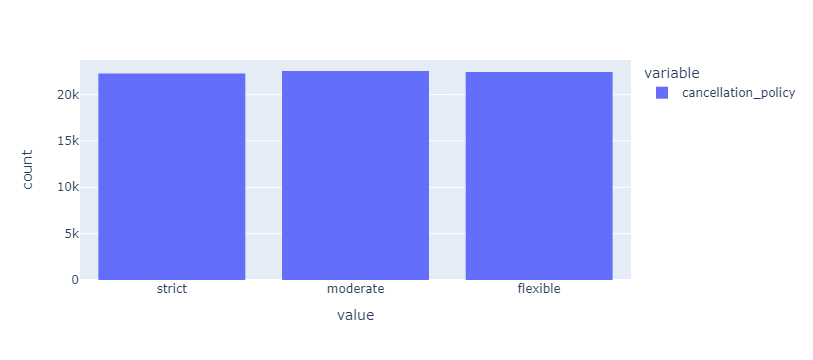

In [102]:
## let us visualize the distribution of the cancellation policy
fig = px.histogram(df2['cancellation_policy'])
fig.show()

In [103]:
## let us impute the cancellation_policy with 'moderate'
df2['cancellation_policy'].replace(np.nan, 'moderate', inplace = True)

In [110]:
df2['instant_bookable'].value_counts()

False    33904
True     33385
Name: instant_bookable, dtype: int64

In [109]:
df2['instant_bookable'].replace(np.nan, False, inplace = True)

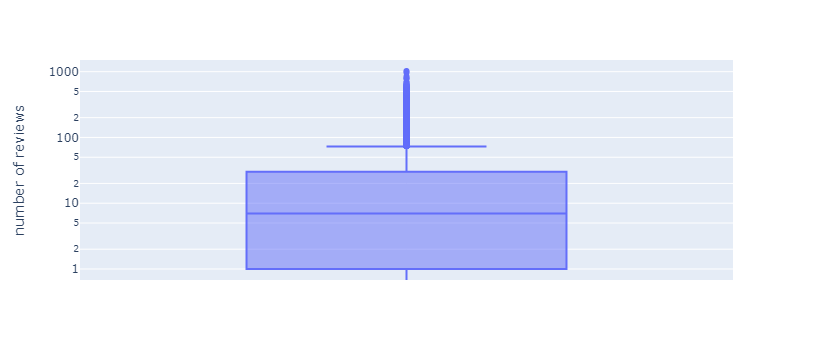

In [113]:
## number of reviews 
fig = px.box(df2,y = 'number of reviews', log_y = True)
fig.show()

In [114]:
df2['number of reviews'].fillna(df2['number of reviews'].median(), inplace = True)

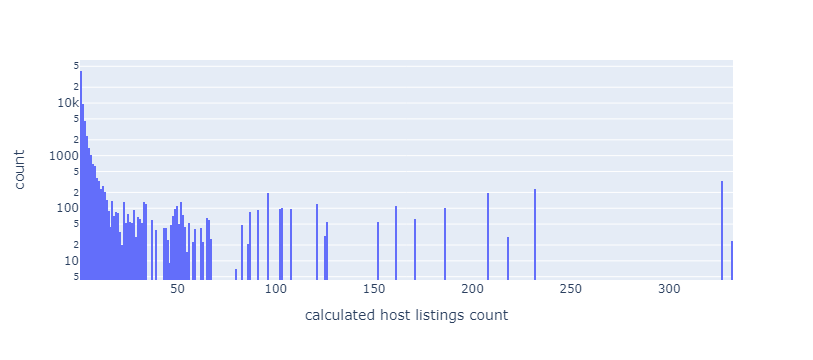

In [118]:
## calculated host listings count

fig = px.histogram(df2,x = 'calculated host listings count',log_y = True)
fig.show()

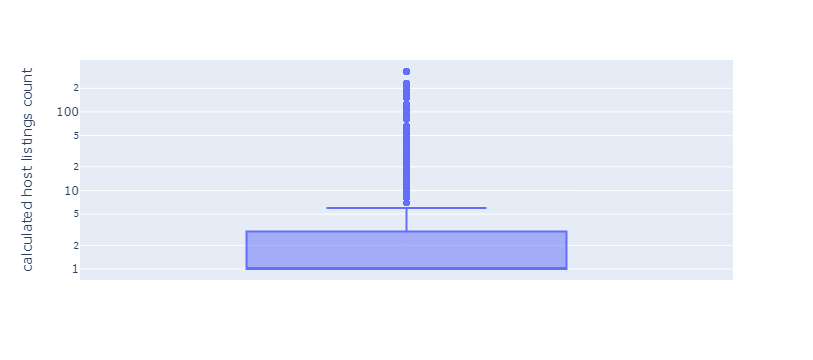

In [120]:
fig = px.box(df2, y = 'calculated host listings count', log_y = True)
fig.show()

In [121]:
df2['calculated host listings count'].fillna(df2['calculated host listings count'].median, inplace = True)

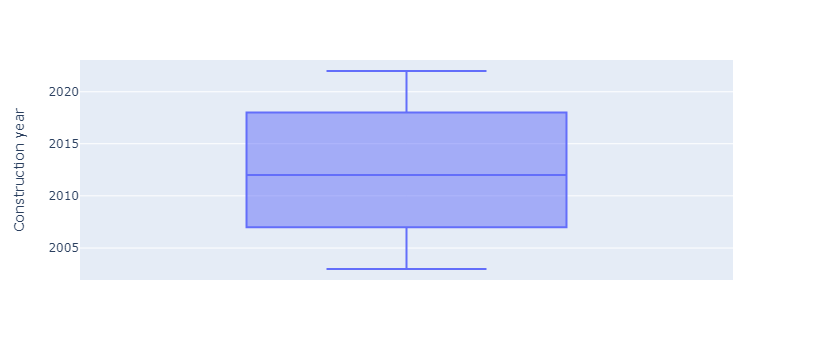

In [122]:
## Construction year

fig = px.box(df2, y = 'Construction year', log_y = True)
fig.show()

In [123]:
df2['Construction year'].fillna(df2['Construction year'].median(), inplace = True)

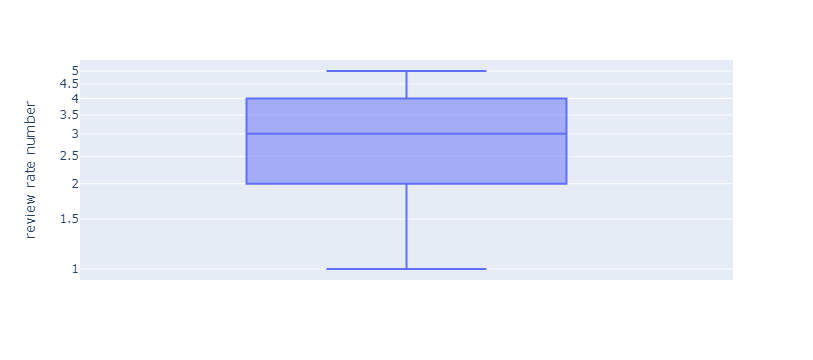

In [124]:
## review rate number
fig = px.box(df2,y = 'review rate number', log_y = True)
fig.show()

In [125]:
df2['review rate number'].fillna(df2['review rate number'].median(), inplace = True)

**Checking null values again**

In [126]:
df2.isnull().sum().sort_values(ascending = False)

minimum nights                    362
availability 365                  321
service fee                       233
price                             216
id                                  0
Construction year                   0
calculated host listings count      0
review rate number                  0
reviews per month                   0
last review                         0
number of reviews                   0
room type                           0
NAME                                0
cancellation_policy                 0
instant_bookable                    0
long                                0
lat                                 0
neighbourhood                       0
neighbourhood group                 0
host name                           0
host_identity_verified              0
host id                             0
house_rules                         0
dtype: int64

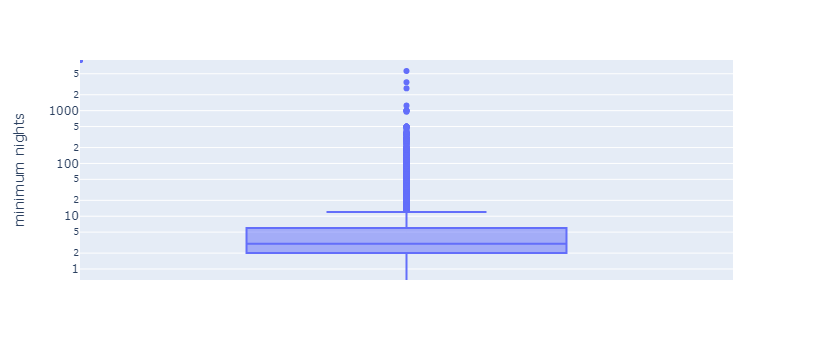

In [128]:
## minimum nights 
fig = px.box(df2, y = 'minimum nights', log_y = True)
fig.show()

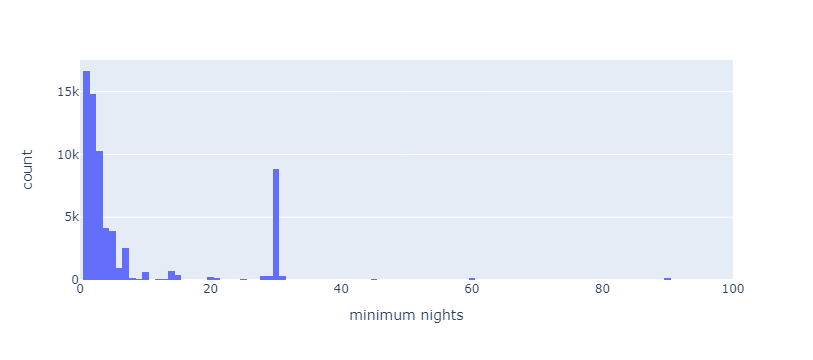

In [140]:
fig = px.histogram(df2, x = 'minimum nights')
fig.update_xaxes(range= [0,100])
fig.show()

In [130]:
## check the minimum and maximum value for the minimum nights 
print('Minimum value:', df2['minimum nights'].min())
print('Maximum value:', df2['minimum nights'].max())

Minimum value: -1223.0
Maximum value: 5645.0


In [131]:
## obviously the minimum number of nights cannot be a negative number so we need to clip the lower limit as well
## as the upper limit

In [141]:
## from the above histogram we can see that the mininum nights count for values above 30 is very low so we can 
## clip the values from 0 to 30

In [142]:
df2['minimum nights'].clip(lower = 0, upper = 30, inplace = True)

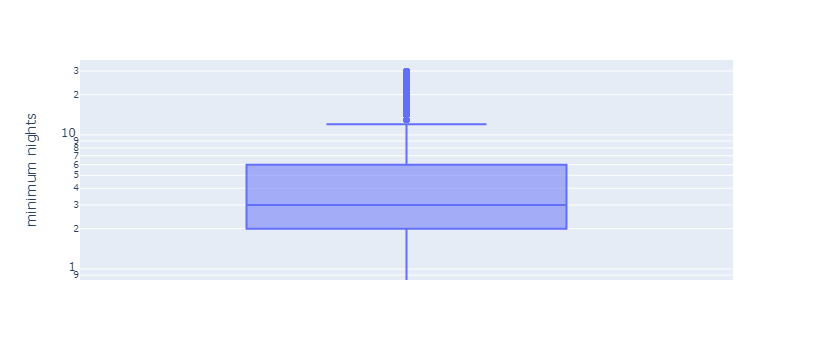

In [144]:
## now visualise the plots again
fig = px.box(df2, y = 'minimum nights', log_y = True)
fig.show()

In [145]:
## now we can substitute the missing values with the median 
df2['minimum nights'].fillna(df2['minimum nights'].median(), inplace = True)

In [146]:
df2.isnull().sum().sort_values(ascending = False)

availability 365                  321
service fee                       233
price                             216
id                                  0
Construction year                   0
calculated host listings count      0
review rate number                  0
reviews per month                   0
last review                         0
number of reviews                   0
minimum nights                      0
room type                           0
NAME                                0
cancellation_policy                 0
instant_bookable                    0
long                                0
lat                                 0
neighbourhood                       0
neighbourhood group                 0
host name                           0
host_identity_verified              0
host id                             0
house_rules                         0
dtype: int64

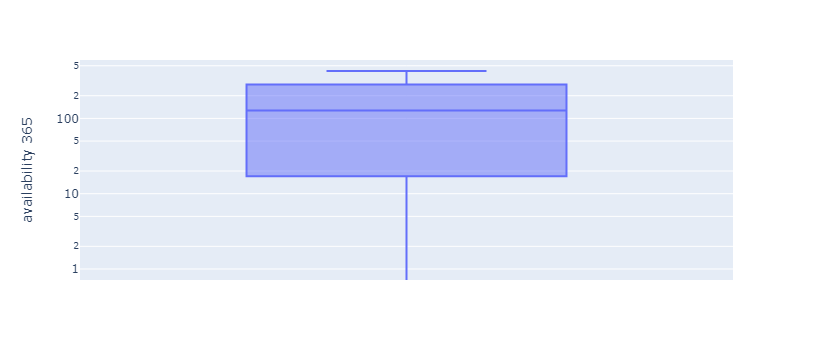

In [147]:
## availability 365 
fig = px.box(df2, y = 'availability 365', log_y = True)
fig.show()

In [149]:
## since availability 365 is the total number of days in a year the listing is available for booking we have to clip
## between 0 to 365

In [150]:
df2['availability 365'].clip(lower = 0, upper = 365, inplace = True)

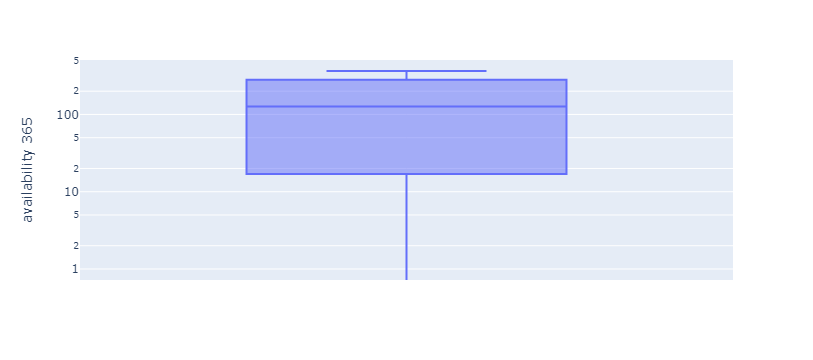

In [151]:
fig = px.box(df2, y= 'availability 365', log_y = True )
fig.show()

In [152]:
df2['availability 365'].fillna(df2['availability 365'].median(), inplace = True)

In [155]:
df2.isnull().sum().sort_values(ascending = False)

service fee                       233
price                             216
id                                  0
Construction year                   0
availability 365                    0
calculated host listings count      0
review rate number                  0
reviews per month                   0
last review                         0
number of reviews                   0
minimum nights                      0
room type                           0
NAME                                0
cancellation_policy                 0
instant_bookable                    0
long                                0
lat                                 0
neighbourhood                       0
neighbourhood group                 0
host name                           0
host_identity_verified              0
host id                             0
house_rules                         0
dtype: int64

In [156]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 67289 entries, 0 to 102049
Data columns (total 23 columns):
 #   Column                          Non-Null Count  Dtype         
---  ------                          --------------  -----         
 0   id                              67289 non-null  int64         
 1   NAME                            67289 non-null  object        
 2   host id                         67289 non-null  int64         
 3   host_identity_verified          67289 non-null  object        
 4   host name                       67289 non-null  object        
 5   neighbourhood group             67289 non-null  object        
 6   neighbourhood                   67289 non-null  object        
 7   lat                             67289 non-null  float64       
 8   long                            67289 non-null  float64       
 9   instant_bookable                67289 non-null  bool          
 10  cancellation_policy             67289 non-null  object        
 11  r

In [160]:
## converting the price from an object to float data type
import re

In [169]:
idx = df2.loc[~df2['price'].isnull()].index

In [175]:
df2.loc[idx,'price'] = df2.loc[idx].apply(lambda x: re.sub(r'\D','',x.price), axis = 1)
df2['price'] = pd.to_numeric(df2['price'])

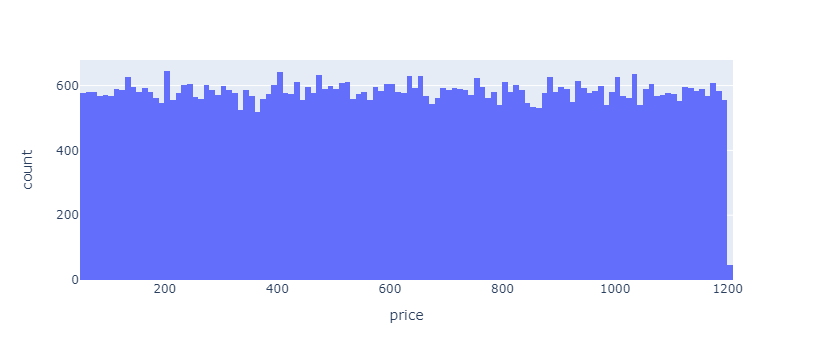

In [180]:
fig = px.histogram(df2, x = 'price')
fig.show()

In [181]:
## imputing price with the mean value
df2['price'].fillna(df2['price'].mean(), inplace = True)

In [182]:
df2.isnull().sum().sort_values(ascending = False)

service fee                       233
id                                  0
Construction year                   0
availability 365                    0
calculated host listings count      0
review rate number                  0
reviews per month                   0
last review                         0
number of reviews                   0
minimum nights                      0
price                               0
room type                           0
NAME                                0
cancellation_policy                 0
instant_bookable                    0
long                                0
lat                                 0
neighbourhood                       0
neighbourhood group                 0
host name                           0
host_identity_verified              0
host id                             0
house_rules                         0
dtype: int64

In [187]:
## convert service fee to numeric 

idx = df2.loc[~df2['service fee'].isnull()].index

df2.loc[idx,'service fee'] = df2.loc[idx].apply(lambda x: re.sub(r'\D','',x['service fee']), axis = 1)
df2['service fee'] = pd.to_numeric(df2['service fee'])

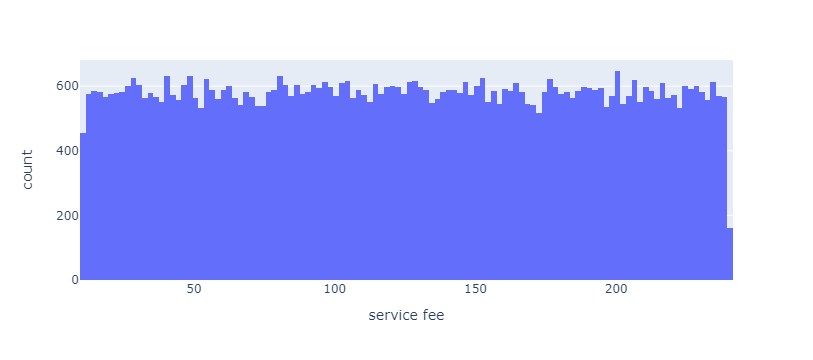

In [188]:
fig = px.histogram(df2, x = 'service fee')
fig.show()

In [189]:
## can impute with the mean
df2['service fee'].fillna(df2['service fee'].mean(), inplace = True)

In [190]:
df2.isnull().sum()

id                                0
NAME                              0
host id                           0
host_identity_verified            0
host name                         0
neighbourhood group               0
neighbourhood                     0
lat                               0
long                              0
instant_bookable                  0
cancellation_policy               0
room type                         0
Construction year                 0
price                             0
service fee                       0
minimum nights                    0
number of reviews                 0
last review                       0
reviews per month                 0
review rate number                0
calculated host listings count    0
availability 365                  0
house_rules                       0
dtype: int64

In [191]:
## the dataset is clean and now we can save it 
df2.to_csv('clean_airbnb')